In [ ]:
from google.colab import drive
drive.mount('/content/drive')
!mkdir /content/MyDrive
!mount --bind /content/drive/My\ Drive /content/MyDrive
# the magic % will help with the cd command :)
%cd /content

In [ ]:
!pip install scanpy
!pip install squidpy
!pip install scikit-image
!pip install tangram-sc
!pip install gdown
# to upgrade
!pip install --upgrade gdown

In [1]:
import scanpy as sc
import squidpy as sq
import numpy as np
import pandas as pd
from anndata import AnnData
import pathlib
import matplotlib.pyplot as plt
import matplotlib as mpl
import skimage
import seaborn as sns
import tangram as tg

# 1. Load in Files

There are 3 files you have to load in to this notebook.

1. `adata_sc`: The single cell data file

2. `adata_st`: The preprocessed spatial data file. It is a result of the previous notebook `Tangram_GPU.ipynb`. 

3. `ad_map`: The spatial mapping file. It is a result of the previous notebook `Tangram_GPU.ipynb`.

In [2]:
adata_sc = sc.read_h5ad("pasca.log1p_liger_med_singleR_noglyc.h5ad")
adata_st = sc.read_h5ad("adata_st_postproj.h5ad")
ad_map = sc.read_h5ad("ad_map.h5ad")
#ad_ge = sc.read_h5ad("ad_ge.h5ad")

# 2. Analyzing data

## 2.1 Visualizing initial data 

In [3]:
img = sq.datasets.visium_fluo_image_crop()

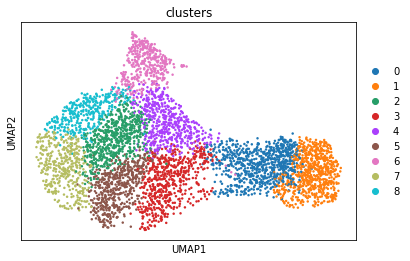

In [4]:
sc.pl.umap(
    adata_st, color=["clusters"], palette=sc.pl.palettes.default_20
)

In [5]:
clusters_colors = dict(
    zip([str(i) for i in range(18)], adata_st.uns["clusters_colors"])
)

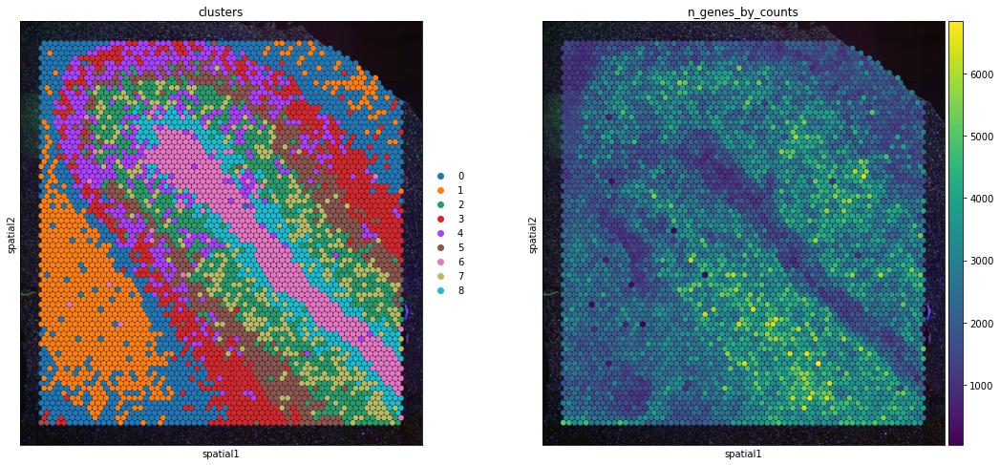

In [6]:
plt.rcParams["figure.figsize"] = (8, 8)
ad = adata_st.copy()
sc.pl.spatial(
  ad,
  img_key="hires",
  color=["clusters","n_genes_by_counts"],
  size=1.5,
  palette=[
    v
    for k, v in clusters_colors.items()
    if k in ad.obs.clusters.unique().tolist()
    ],
  legend_loc='right margin',
  show=False,
    )

plt.tight_layout()

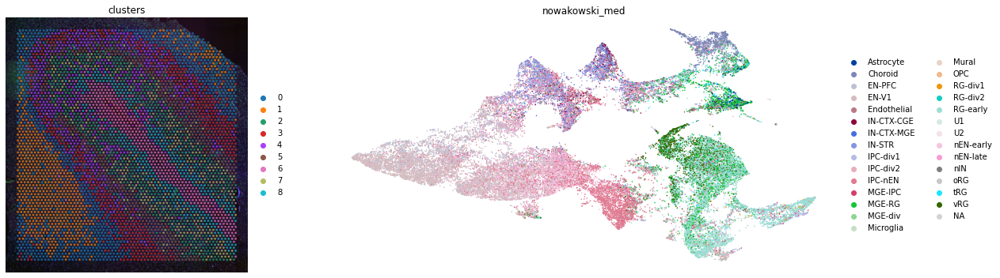

In [7]:
fig, axs = plt.subplots(1, 2, figsize=(20, 5))
sc.pl.spatial(
    adata_st, color="clusters", alpha=0.7, frameon=False, show=False, ax=axs[0]
)
sc.pl.umap(
    adata_sc, color="nowakowski_med", size=10, frameon=False, show=False, ax=axs[1]
)
plt.tight_layout()

## 2.2 Pre-process AnnDatas

This preprocessing is required for `adata_sc` to be in the correct format for further experiments.

In [8]:
adata_sc.uns['log1p']["base"] = None
sc.tl.rank_genes_groups(adata_sc, groupby="nowakowski_med", use_raw=False)
markers_df = pd.DataFrame(adata_sc.uns["rank_genes_groups"]["names"]).iloc[0:100, :]
markers = list(np.unique(markers_df.melt().value.values))
len(markers)
tg.pp_adatas(adata_sc, adata_st, genes=markers)

INFO:root:1301 training genes are saved in `uns``training_genes` of both single cell and spatial Anndatas.
INFO:root:21181 overlapped genes are saved in `uns``overlap_genes` of both single cell and spatial Anndatas.
INFO:root:uniform based density prior is calculated and saved in `obs``uniform_density` of the spatial Anndata.
INFO:root:rna count based density prior is calculated and saved in `obs``rna_count_based_density` of the spatial Anndata.


In [9]:
# alternative 2: saving the experiment result from the previous gpu notebook can be used but pp_adatas don't take much time.
# It is not worth generating another intermediate file.
#adata_sc = sc.read_h5ad("adata_sc.h5ad")

## 2.3 Visualize cell type maps

INFO:root:spatial prediction dataframe is saved in `obsm` `tangram_ct_pred` of the spatial AnnData.


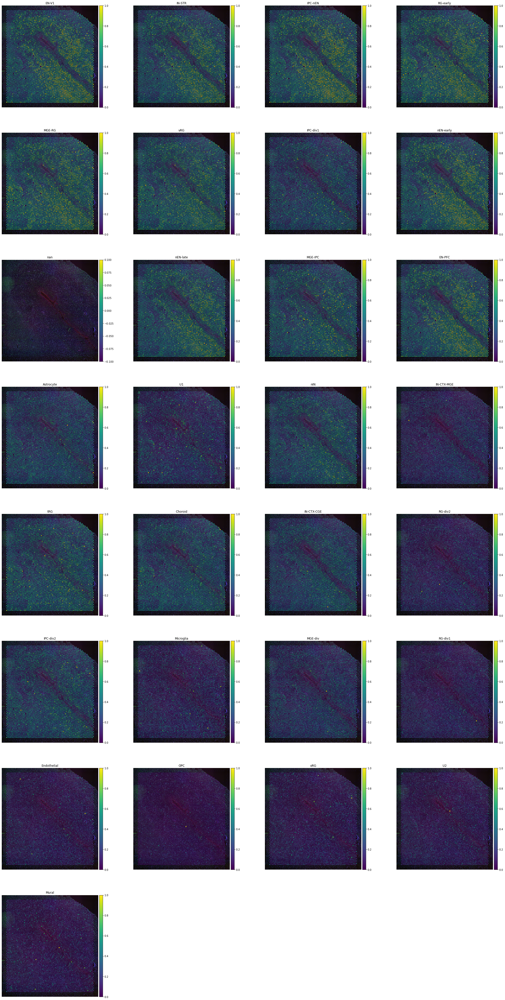

In [10]:
tg.project_cell_annotations(ad_map, adata_st, annotation="nowakowski_med")
annotation_list = list(pd.unique(adata_sc.obs['nowakowski_med']))
tg.plot_cell_annotation_sc(adata_st, annotation_list)

In [11]:
#separation of two samples visualize.

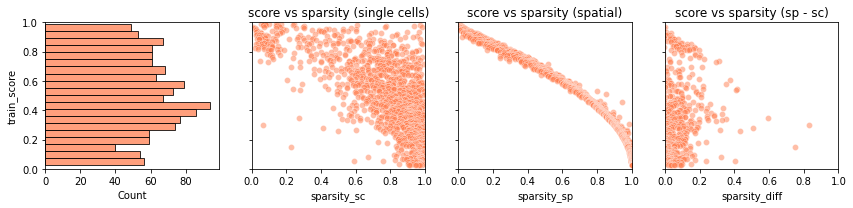

In [12]:
tg.plot_training_scores(ad_map, bins=20, alpha=.5)

## 2.4 Generate new spatial data via aligned single cells

In [13]:
# This part to go to CPU.
ad_ge = tg.project_genes(adata_map=ad_map, adata_sc=adata_sc)
#ad_ge = sc.read_h5ad("ad_ge.h5ad")

In [14]:
import gc
gc.collect()

280416

In [15]:
df_all_genes = tg.compare_spatial_geneexp(ad_ge, adata_st, adata_sc)
df_all_genes

,score,is_training,sparsity_sp,sparsity_sc,sparsity_diff
mt-nd4,0.989244,True,0.000000,0.099328,-0.099328
mt-co1,0.988705,True,0.000000,0.054983,-0.054983
mt-co2,0.988599,True,0.000407,0.074579,-0.074171
mt-co3,0.988458,True,0.000204,0.077410,-0.077206
mt-atp6,0.988149,True,0.000000,0.166763,-0.166763
...,...,...,...,...,...
al355306.2,0.000631,False,0.999796,0.999978,-0.000182
ap000755.2,0.000473,False,0.999796,0.999978,-0.000182
linc02047,0.000451,False,0.999796,0.999978,-0.000182
ac116021.1,0.000444,False,0.999796,0.999978,-0.000182


<Figure size 576x576 with 0 Axes>

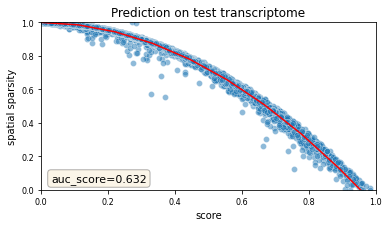

In [16]:
tg.plot_auc(df_all_genes)

### Inspect predictions

In [17]:
# we have to use low letter
GOI=['pax6','sox2','foxg1','neurod2','prodh','ranbp1','crkl','hira']

In [ ]:
tg.plot_genes_sc(GOI, adata_measured=adata_st, adata_predicted=ad_ge, perc=0.02)

In [49]:
adata_st

AnnData object with n_obs × n_vars = 4910 × 25285
    obs: 'in_tissue', 'array_row', 'array_col', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'clusters', 'uniform_density', 'rna_count_based_density'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'n_cells', 'sparsity'
    uns: 'hvg', 'leiden', 'log1p', 'neighbors', 'overlap_genes', 'spatial', 'training_genes', 'umap', 'clusters_colors'
    obsm: 'X_pca', 'X_umap', 'spatial', 'tangram_ct_pred'
    obsp: 'connectivities', 'distances'

two kinds of data, one is the patient the other is control and if we can predicted(control) predicted(patient).

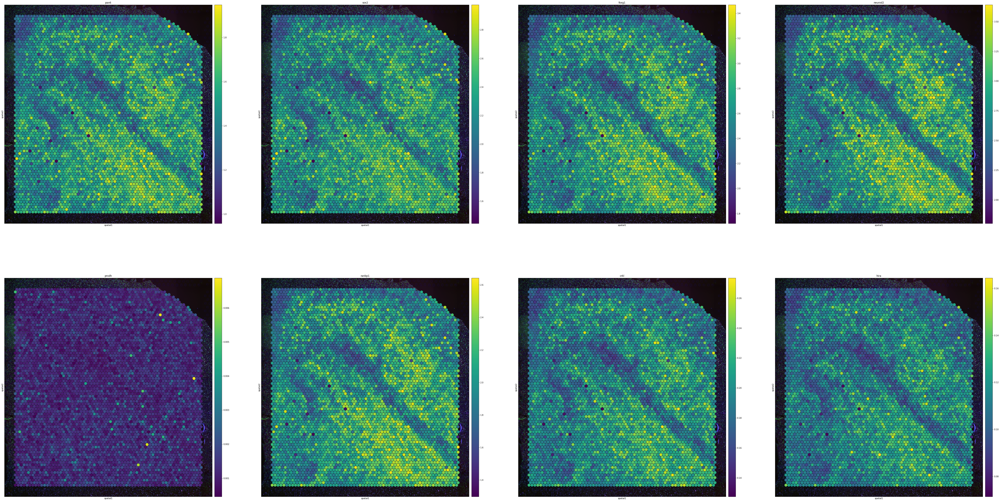

In [18]:
plt.rcParams["figure.figsize"] = (20, 20)
ad = ad_ge.copy()
sc.pl.spatial(
  ad,
  img_key="hires",
  color=GOI,
  size=1.5,
  palette=[
    v
    for k, v in clusters_colors.items()
    if k in ad.obs.clusters.unique().tolist()
    ],
  legend_loc='right margin',
  show=False,
    )

plt.tight_layout()

## 2.? Try to compare two groups

In [19]:
adata_st

AnnData object with n_obs × n_vars = 4910 × 25285
    obs: 'in_tissue', 'array_row', 'array_col', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'clusters', 'uniform_density', 'rna_count_based_density'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'n_cells', 'sparsity'
    uns: 'hvg', 'leiden', 'log1p', 'neighbors', 'overlap_genes', 'spatial', 'training_genes', 'umap', 'clusters_colors'
    obsm: 'X_pca', 'X_umap', 'spatial', 'tangram_ct_pred'
    obsp: 'connectivities', 'distances'

In [20]:
adata_sc

AnnData object with n_obs × n_vars = 45214 × 25392
    obs: 'batch', 'condition', 'sampleID', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_counts_ribo_p', 'percent_ribo_p', 'sf', 'leiden', 'nowakowski_med'
    var: 'gene_ids', 'feature_types', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'sparsity'
    uns: 'batch_colors', 'condition_colors', 'leiden', 'log1p', 'neighbors', 'umap', 'nowakowski_med_colors', 'rank_genes_groups', 'training_genes', 'overlap_genes'
    obsm: 'X_liger', 'X_umap'
    layers: 'counts', 'sf'
    obsp: 'connectivities', 'distances'

In [21]:
ad_map

AnnData object with n_obs × n_vars = 45214 × 4910
    obs: 'batch', 'condition', 'sampleID', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_counts_ribo_p', 'percent_ribo_p', 'sf', 'leiden', 'nowakowski_med'
    var: 'in_tissue', 'array_row', 'array_col', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'clusters', 'uniform_density', 'rna_count_based_density'
    uns: 'train_genes_df', 'training_history'

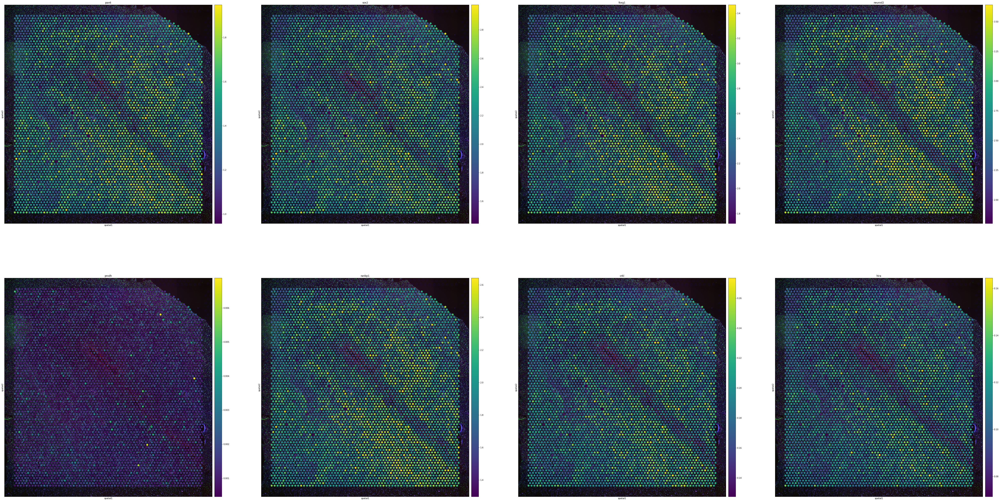

In [22]:
GOI=['pax6','sox2','foxg1','neurod2','prodh','ranbp1','crkl','hira']
sc.pl.spatial(
            ad_ge,
            color=GOI
        )

## 2.5 Deconvolution via alignment

In [23]:
sf = adata_st.uns['spatial']['V1_Human_Brain_Section_1']["scalefactors"]["tissue_hires_scalef"]
img = sq.im.ImageContainer(adata_st.uns['spatial']['V1_Human_Brain_Section_1']['images']['hires'],
                           scale = sf, library_id = 'V1_Human_Brain_Section_1')

In [24]:
sq.im.process(img=img, layer="image", method="smooth")
sq.im.segment(                                                                                
    img=img,
    layer="image_smooth",
    method="watershed",
    channel=0,
)

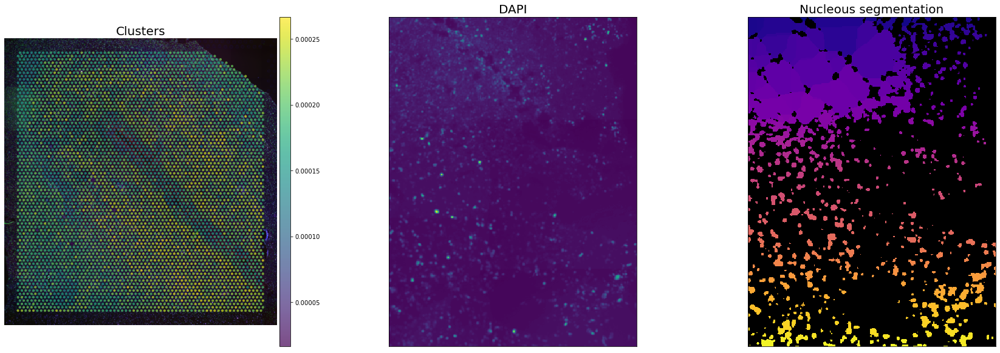

In [25]:
inset_y = 1500
inset_x = 1700
inset_sy = 400
inset_sx = 500

fig, axs = plt.subplots(1, 3, figsize=(30, 10))
# spatial how?
sc.pl.spatial(
    adata_st, 
    color="rna_count_based_density",   
    alpha=0.7, frameon=False, show=False, ax=axs[0], title=""
)
axs[0].set_title("Clusters", fontdict={"fontsize": 20})
rect = mpl.patches.Rectangle(
    (inset_y * sf, inset_x * sf),
    width=inset_sx * sf,
    height=inset_sy * sf,
    ec="yellow",
    lw=4,
    fill=False,
)
axs[0].add_patch(rect)

axs[0].axes.xaxis.label.set_visible(False)
axs[0].axes.yaxis.label.set_visible(False)

axs[1].imshow(
    img["image"][inset_y : inset_y + inset_sy, inset_x : inset_x + inset_sx, 0, 0]
    / 65536,
    interpolation="none",
)
axs[1].grid(False)
axs[1].set_xticks([])
axs[1].set_yticks([])
axs[1].set_title("DAPI", fontdict={"fontsize": 20})

crop = img["segmented_watershed"][
    inset_y : inset_y + inset_sy, inset_x : inset_x + inset_sx
].values.squeeze(-1)
crop = skimage.segmentation.relabel_sequential(crop)[0]
cmap = plt.cm.plasma
cmap.set_under(color="black")
axs[2].imshow(crop, interpolation="none", cmap=cmap, vmin=0.001)
axs[2].grid(False)
axs[2].set_xticks([])
axs[2].set_yticks([])
axs[2].set_title("Nucleous segmentation", fontdict={"fontsize": 20});

In [26]:
features_kwargs = {
    "segmentation": {
        "label_layer": "segmented_watershed",
        "props": ["label", "centroid"],
        "channels": [1, 2],
    }
}
# calculate segmentation features
sq.im.calculate_image_features(
    adata_st,
    img,
    layer="image",
    key_added="image_features",
    n_jobs=4,
    features_kwargs=features_kwargs,
    features="segmentation",
    mask_circle=True,
)

  0%|          | 0/4910 [00:00<?, ?/s]

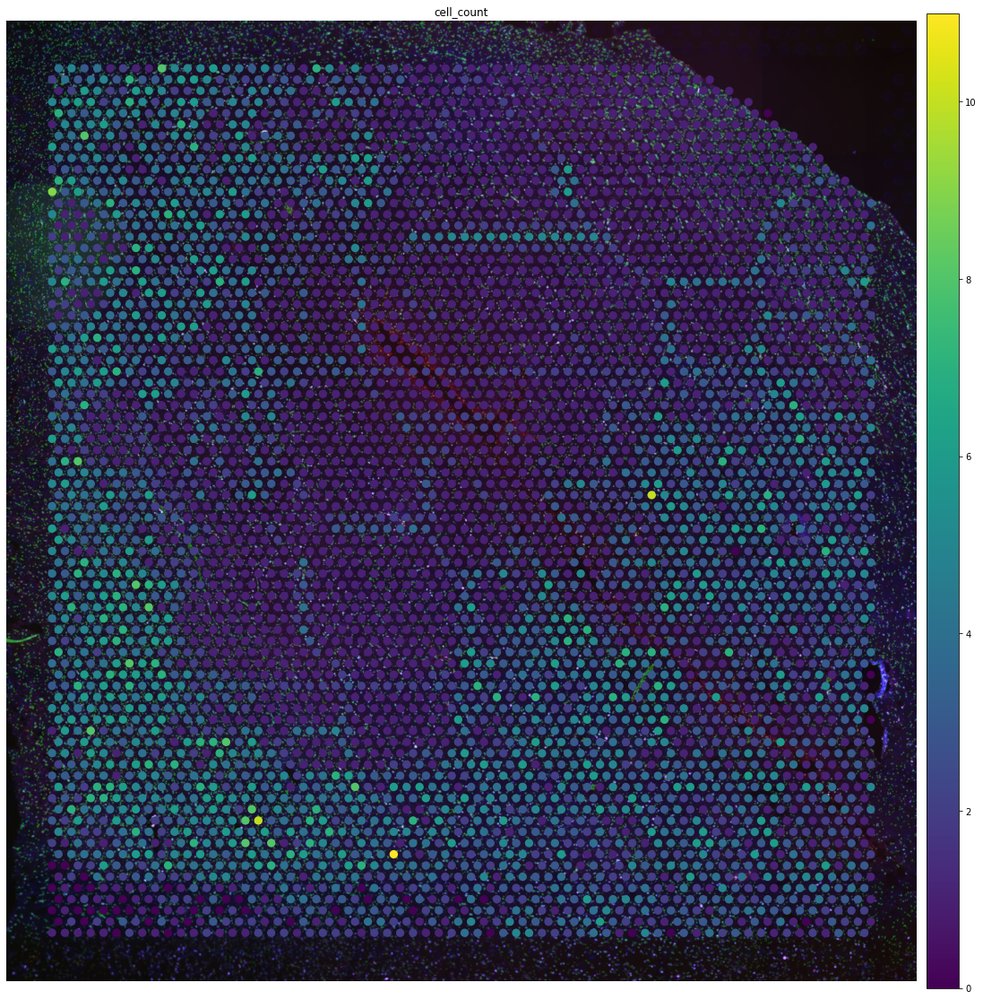

In [27]:
adata_st.obs["cell_count"] = adata_st.obsm["image_features"]["segmentation_label"]
sc.pl.spatial(adata_st, color=["cell_count"], frameon=False)

In [28]:
adata_st.obsm['image_features']

,segmentation_label,segmentation_centroid
AAACAAGTATCTCCCA-1,1,"[[nan, nan]]"
AAACAATCTACTAGCA-1,1,"[[nan, nan]]"
AAACACCAATAACTGC-1,5,"[[1611.0, 1379.0609874152954], [1616.680272108..."
AAACAGAGCGACTCCT-1,2,"[[761.0, 496.0], [776.0, 481.0]]"
AAACAGCTTTCAGAAG-1,2,"[[1725.0, 1054.0], [1740.0, 1069.0]]"
...,...,...
TTGTTTCACATCCAGG-1,4,"[[1350.0, 1365.0], [1357.4685354691076, 1358.1..."
TTGTTTCATTAGTCTA-1,1,"[[nan, nan]]"
TTGTTTCCATACAACT-1,6,"[[1521.0, 1106.4974958263772], [1524.698901098..."
TTGTTTGTATTACACG-1,2,"[[1362.0, 1646.0], [1377.0, 1661.0]]"


In [34]:
ad = adata_st.copy()
print(ad.var_names)
ad.obs.columns
#sq.pl.spatial_scatter(ad, color=["nowakowski_med"])

Index(['al627309.1', 'al627309.5', 'al669831.2', 'linc01409', 'fam87b',
       'linc01128', 'linc00115', 'fam41c', 'al645608.4', 'linc02593',
       ...
       'mt-cyb', 'bx004987.1', 'ac145212.1', 'mafip', 'ac011043.1',
       'al354822.1', 'ac240274.1', 'ac023491.2', 'ac007325.4', 'ac007325.2'],
      dtype='object', length=25285)


Index(['in_tissue', 'array_row', 'array_col', 'n_genes_by_counts',
       'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts',
       'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes',
       'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes',
       'clusters', 'uniform_density', 'rna_count_based_density', 'cell_count'],
      dtype='object')

In [35]:
ad

AnnData object with n_obs × n_vars = 4910 × 25285
    obs: 'in_tissue', 'array_row', 'array_col', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'clusters', 'uniform_density', 'rna_count_based_density', 'cell_count'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'n_cells', 'sparsity'
    uns: 'hvg', 'leiden', 'log1p', 'neighbors', 'overlap_genes', 'spatial', 'training_genes', 'umap', 'clusters_colors'
    obsm: 'X_pca', 'X_umap', 'spatial', 'tangram_ct_pred', 'image_features'
    obsp: 'connectivities', 'distances'

In [37]:
tg.create_segment_cell_df(ad)
ad.uns["tangram_cell_segmentation"].head()

,spot_idx,y,x,centroids
0,AAACAAGTATCTCCCA-1,NaN,NaN,AAACAAGTATCTCCCA-1_0
1,AAACAATCTACTAGCA-1,NaN,NaN,AAACAATCTACTAGCA-1_0
2,AAACACCAATAACTGC-1,1611.000000,1379.060987,AAACACCAATAACTGC-1_0
3,AAACACCAATAACTGC-1,1616.680272,1380.537962,AAACACCAATAACTGC-1_1
4,AAACACCAATAACTGC-1,1621.907738,1385.000000,AAACACCAATAACTGC-1_2


In [38]:
ad.obs = pd.concat([adata_st.obs, adata_st.obsm["tangram_ct_pred"]], axis=1)
annotation_list = ad_map.obs['nowakowski_med']
annotation_list

In [44]:
ad

AnnData object with n_obs × n_vars = 4910 × 25285
    obs: 'in_tissue', 'array_row', 'array_col', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'clusters', 'uniform_density', 'rna_count_based_density', 'cell_count', 'EN-V1', 'IN-STR', 'IPC-nEN', 'RG-early', 'MGE-RG', 'vRG', 'IPC-div1', 'nEN-early', nan, 'nEN-late', 'MGE-IPC', 'EN-PFC', 'Astrocyte', 'U1', 'nIN', 'IN-CTX-MGE', 'tRG', 'Choroid', 'IN-CTX-CGE', 'RG-div2', 'IPC-div2', 'Microglia', 'MGE-div', 'RG-div1', 'Endothelial', 'OPC', 'oRG', 'U2', 'Mural', 'nowakowski_med'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'n_cells', 'sparsity'
    uns: 'hvg', 'leiden', 'log1p', 'neighbors', 'overla

In [45]:
ad_map

AnnData object with n_obs × n_vars = 45214 × 4910
    obs: 'batch', 'condition', 'sampleID', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_counts_ribo_p', 'percent_ribo_p', 'sf', 'leiden', 'nowakowski_med'
    var: 'in_tissue', 'array_row', 'array_col', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'clusters', 'uniform_density', 'rna_count_based_density'
    uns: 'train_genes_df', 'training_history'

In [46]:
adata_sc

AnnData object with n_obs × n_vars = 45214 × 25392
    obs: 'batch', 'condition', 'sampleID', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_counts_ribo_p', 'percent_ribo_p', 'sf', 'leiden', 'nowakowski_med'
    var: 'gene_ids', 'feature_types', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'sparsity'
    uns: 'batch_colors', 'condition_colors', 'leiden', 'log1p', 'neighbors', 'umap', 'nowakowski_med_colors', 'rank_genes_groups', 'training_genes', 'overlap_genes'
    obsm: 'X_liger', 'X_umap'
    layers: 'counts', 'sf'
    obsp: 'connectivities', 'distances'

In [75]:
xs = ad.obsm["spatial"][:, 1]
ys = ad.obsm["spatial"][:, 0]
cell_count = ad.obsm["image_features"]["segmentation_label"]

df_segmentation = ad.uns["tangram_cell_segmentation"]
centroids = ad.obsm["tangram_spot_centroids"]

    # create a dataframe
df_vox_cells = df_vox_cells = pd.DataFrame(
    data={"x": xs, "y": ys, "cell_n": cell_count, "centroids": centroids},
    index=list(ad.obs.index),
)
df_vox_cells

,x,y,cell_n,centroids
AAACAAGTATCTCCCA-1,14537,8210,1,[AAACAAGTATCTCCCA-1_0]
AAACAATCTACTAGCA-1,3296,16323,1,[AAACAATCTACTAGCA-1_0]
AAACACCAATAACTGC-1,16692,19620,5,"[AAACACCAATAACTGC-1_0, AAACACCAATAACTGC-1_1, A..."
AAACAGAGCGACTCCT-1,5925,9311,2,"[AAACAGAGCGACTCCT-1_0, AAACAGAGCGACTCCT-1_1]"
AAACAGCTTTCAGAAG-1,12865,20995,2,"[AAACAGCTTTCAGAAG-1_0, AAACAGCTTTCAGAAG-1_1]"
...,...,...,...,...
TTGTTTCACATCCAGG-1,16452,16458,4,"[TTGTTTCACATCCAGG-1_0, TTGTTTCACATCCAGG-1_1, T..."
TTGTTTCATTAGTCTA-1,16931,18107,1,[TTGTTTCATTAGTCTA-1_0]
TTGTTTCCATACAACT-1,13343,18521,6,"[TTGTTTCCATACAACT-1_0, TTGTTTCCATACAACT-1_1, T..."
TTGTTTGTATTACACG-1,20040,16594,2,"[TTGTTTGTATTACACG-1_0, TTGTTTGTATTACACG-1_1]"


In [60]:
def one_hot_encoding(l, keep_aggregate=False):
    df_enriched = pd.DataFrame({"cl": l})
    for i in l.unique():
        df_enriched[i] = list(map(int, df_enriched["cl"] == i))
    if not keep_aggregate:
        del df_enriched["cl"]
    return df_enriched

In [95]:
resulting_voxels = np.argmax(ad_map.X, axis=1)
if "F_out" in ad_map.obs.keys():
    filtered_voxels_to_types = [
        (j, adata_sc.obs['nowakowski_med'][k])
        for i, j, k in zip(
            ad_map.obs["F_out"], resulting_voxels, range(len(adata_sc))
        )
        if i > threshold
    ]

    vox_ct = filtered_voxels_to_types

else:
    vox_ct = [(resulting_voxels, adata_sc.obs['nowakowski_med'])]
print(len(resulting_voxels))
print(len(adata_sc.obs['nowakowski_med']))
df_classes = one_hot_encoding(adata_sc.obs['nowakowski_med'])
for index, i in enumerate(df_classes.columns):
    df_vox_cells[i] = 0
colnames = list(df_vox_cells.columns)
print(colnames)
nan_ind = colnames.index(np.nan)
print(ind)
for i in range(0, len(resulting_voxels)):
    k = resulting_voxels[i]
    v = adata_sc.obs["nowakowski_med"][i]
    if(v is not np.nan):
        ind = df_vox_cells.columns.get_loc(v)
    else:
        ind = nan_ind
    df_vox_cells.iloc[k, ind] += 1

ad.obsm["tangram_ct_count"] = df_vox_cells

45214
45214
['x', 'y', 'cell_n', 'centroids', 'EN-V1', 'IN-STR', 'IPC-nEN', 'RG-early', 'MGE-RG', 'vRG', 'IPC-div1', 'nEN-early', nan, 'nEN-late', 'MGE-IPC', 'EN-PFC', 'Astrocyte', 'U1', 'nIN', 'IN-CTX-MGE', 'tRG', 'Choroid', 'IN-CTX-CGE', 'RG-div2', 'IPC-div2', 'Microglia', 'MGE-div', 'RG-div1', 'Endothelial', 'OPC', 'oRG', 'U2', 'Mural']
7


In [ ]:
tg.count_cell_annotations(
    adata_map = ad_map,
    adata_sc = adata_sc,
    adata_sp = ad,
    annotation = 'nowakowski_med'
)
# nowakowski_med
adata_st.obsm["tangram_ct_count"].head()

In [96]:
adata_segment = tg.deconvolve_cell_annotations(ad)
adata_segment.obs.head()

,y,x,centroids,cluster
0,1611.000000,1379.060987,AAACACCAATAACTGC-1_0,IPC-nEN
1,1616.680272,1380.537962,AAACACCAATAACTGC-1_1,RG-early
2,1621.907738,1385.000000,AAACACCAATAACTGC-1_2,RG-early
3,1618.420635,1370.000000,AAACACCAATAACTGC-1_3,RG-early
4,1626.000000,1378.247822,AAACACCAATAACTGC-1_4,vRG
